In [1]:
import sys
sys.path.insert(0, '/cndd/fangming/CEMBA/snmcseq_dev')
import tqdm
from matplotlib.cm import get_cmap
import fbpca

from __init__ import *
from __init__jupyterlab import *
import snmcseq_utils

# Read in data 

In [2]:
DATA_DIR = '/datasets/Public_Datasets/Vizgen_MERFISH_mouse_brain'
data_dir = DATA_DIR

In [3]:
slicenames = [
    "Slice1",
    "Slice2",
    "Slice3",
]
replicates = [
    "Replicate1",
    "Replicate2",
    "Replicate3",
]
ti = time.time()

alldata = {}
cell_covs = {}

i = 0
for slicename in slicenames:
    for replicate in replicates:
        sample_name = '{}_{}'.format(slicename, replicate)
        print(sample_name)
        fdata = os.path.join(data_dir, '{}/{}/cell_by_gene.csv'.format(slicename, replicate))
        fmeta = os.path.join(data_dir, '{}/{}/cell_metadata.csv'.format(slicename, replicate))

        # read in
        data = pd.read_csv(fdata, index_col=0)
        meta = pd.read_csv(fmeta, index_col=0)
        data = data.drop(data.filter(regex='^Blank-').columns, axis=1)
        if i == 0:
            genes = data.columns
        else:
            assert np.all(genes == data.columns)
            
        # process
        cell_cov = data.sum(axis=1)
        data_norm = data.divide(cell_cov, axis=0)
        data_comb = meta.join(data_norm)
        
        # record
        i += 1
        alldata[sample_name] = data_comb
        cell_covs[sample_name] = cell_cov
        print(time.time()-ti)

Slice1_Replicate1
13.123213052749634
Slice1_Replicate2
28.037615060806274
Slice1_Replicate3
41.49807596206665
Slice2_Replicate1
54.0734646320343
Slice2_Replicate2
66.28862237930298
Slice2_Replicate3
77.98601412773132
Slice3_Replicate1
87.85438799858093
Slice3_Replicate2
98.84340834617615
Slice3_Replicate3
106.14285063743591


# Coverage

/cndd2/fangming/venvs/routine/lib/python3.8/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


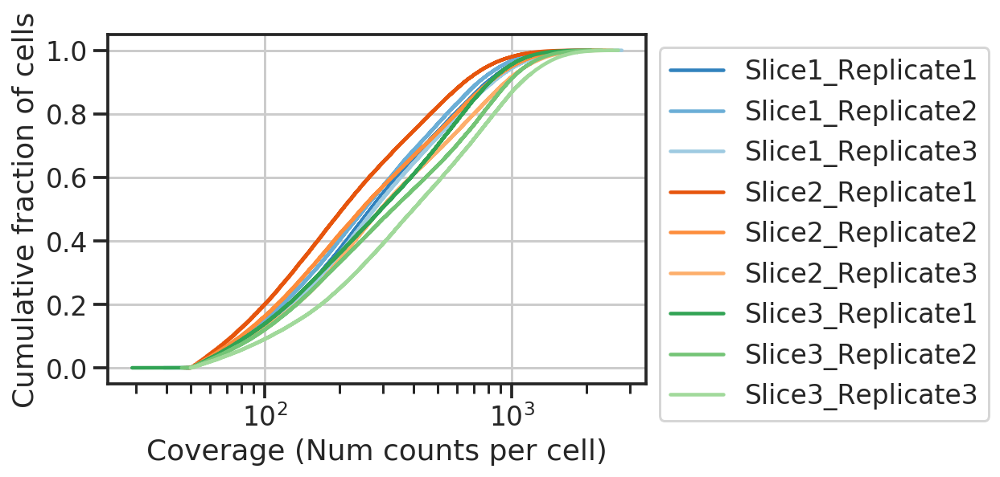

In [4]:
colors = [
    get_cmap('tab20c').colors[0],
    get_cmap('tab20c').colors[1],
    get_cmap('tab20c').colors[2],
    
    get_cmap('tab20c').colors[4],
    get_cmap('tab20c').colors[5],
    get_cmap('tab20c').colors[6],
    
    get_cmap('tab20c').colors[8],
    get_cmap('tab20c').colors[9],
    get_cmap('tab20c').colors[10],
] 
palette = {}
for i, sample in enumerate(alldata.keys()):
    palette[sample] = colors[i] 

fig, ax = plt.subplots()
for sample in alldata.keys():
    color = palette[sample]
    cell_cov = cell_covs[sample]
    med = cell_cov.median()
    snmcseq_utils.gen_cdf(cell_cov, ax=ax, label=sample, color=color)
#     sns.distplot(cell_cov, ax=ax, label=sample_name, color=color, )
#     ax.axvline(med, color=color, linestyle='--')
    
ax.set
ax.legend(bbox_to_anchor=(1,1))
ax.set_xscale('log')
ax.set_xlabel('Coverage (Num counts per cell)')
ax.set_ylabel('Cumulative fraction of cells')
plt.show()

# Visualize 

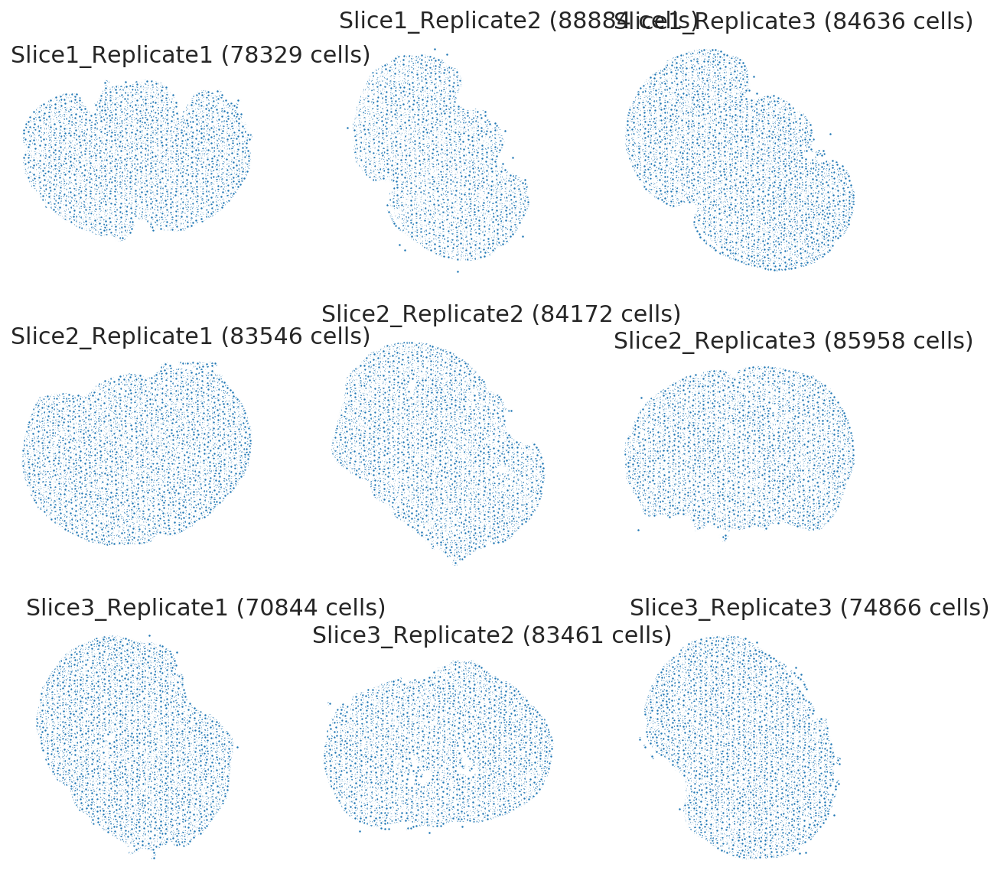

In [5]:
fig, axs = plt.subplots(3, 3, figsize=(10,10))
for ax, sample in zip(axs.flat, alldata.keys()):
    toplot = alldata[sample]
    sns.scatterplot(x='center_x', y='center_y', data=toplot, 
                    s=4, markers=dict(marker_edge_color='none'),
                    rasterized=True,
                    ax=ax,
                   )
    ax.axis('off')
    ax.set_aspect('equal')
    ax.set_title("{} ({} cells)".format(sample, len(toplot)), loc='left', fontsize=15)
plt.show()

# Rotation 

In [53]:
# rotation transformation
def rotate(mat, vec_chiral):
    """(n,2) matrix as input
    """
    U, s, Vt = fbpca.pca(mat, k=2)
    coords = U.dot(np.diag(s))

    # det = -1 reflection; det = 1 rotation
    if np.linalg.det(Vt) < 0: # ~ -1
        coords[:,0] = -coords[:,0]
        Vt[0,:] = -Vt[0,:]
        
    delta = vec_chiral[coords[:,1]>0].sum() - vec_chiral[coords[:,1]<0].sum()
    if delta < 0: # rotate 180 
        coords = -coords
        Vt = -Vt
    
#     # delta enforce chirality
#     r2 = np.power(coords, 2).sum(axis=1)
#     delta = r2[coords[:,1]>0].sum() - r2[coords[:,1]<0].sum()
#     if delta < 0: # rotate 180 
#         coords = -coords
#         Vt = -Vt

    
    return coords, Vt

all_Vts = {}
for sample in alldata.keys():
    toplot = alldata[sample]
    toplot[['x', 'y']], Vt = rotate(toplot[['center_x', 'center_y']].values, toplot['Met'].values)
    all_Vts[sample] = Vt
    print(Vt.dot(Vt.T), np.linalg.det(Vt))

[[ 1.00000000e+00 -1.08626411e-18]
 [-1.08626411e-18  1.00000000e+00]] 1.0
[[ 1.0000000e+00 -1.2602663e-17]
 [-1.2602663e-17  1.0000000e+00]] 1.0000000000000002
[[1.00000000e+00 1.97512611e-17]
 [1.97512611e-17 1.00000000e+00]] 1.0000000000000002
[[ 1.00000000e+00 -1.87693103e-17]
 [-1.87693103e-17  1.00000000e+00]] 1.0
[[ 1.00000000e+00 -2.42671672e-17]
 [-2.42671672e-17  1.00000000e+00]] 1.0
[[1.00000000e+00 1.71243288e-18]
 [1.71243288e-18 1.00000000e+00]] 1.0000000000000002
[[1.00000000e+00 7.07155638e-18]
 [7.07155638e-18 1.00000000e+00]] 0.9999999999999999
[[1.00000000e+00 3.46815204e-18]
 [3.46815204e-18 1.00000000e+00]] 1.0
[[1.00000000e+00 1.88987723e-17]
 [1.88987723e-17 1.00000000e+00]] 1.0000000000000002


-32456580936.345398
-48798640375.986145
-29115689364.233948
-23168751263.26123
17783195107.77173
-22804879209.13971
11631945548.624725
26160302832.687805
-5366776626.800964


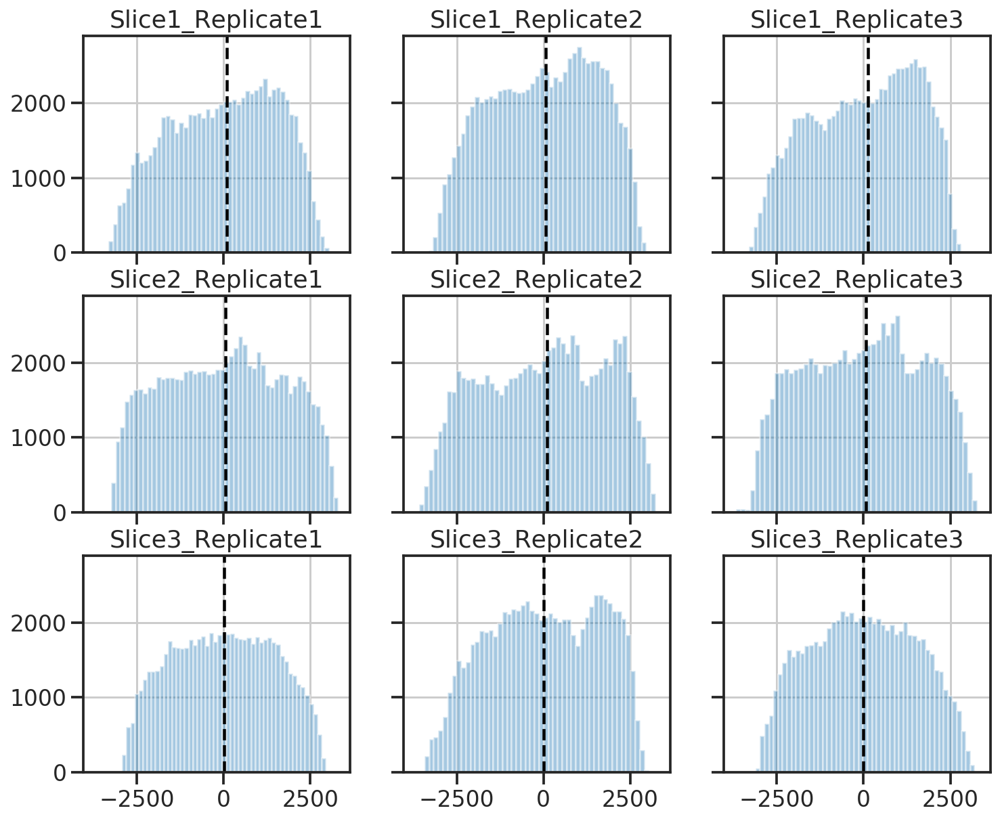

In [54]:
fig, axs = plt.subplots(3, 3, figsize=(12,10), sharex=True, sharey=True)
for i, (ax, sample) in enumerate(zip(axs.flat, alldata.keys())):
    toplot = alldata[sample]
    r2 = np.power(toplot['x'], 2) + np.power(toplot['y'], 2)
    delta = r2[toplot['y']>0].sum() - r2[toplot['y']<0].sum()
    print(delta)
    
    sns.distplot(toplot['y'].values, kde=False, ax=ax)
    ax.axvline(np.median(toplot['y'].values), color='k', linestyle='--')
    ax.set_title(sample)
plt.show()

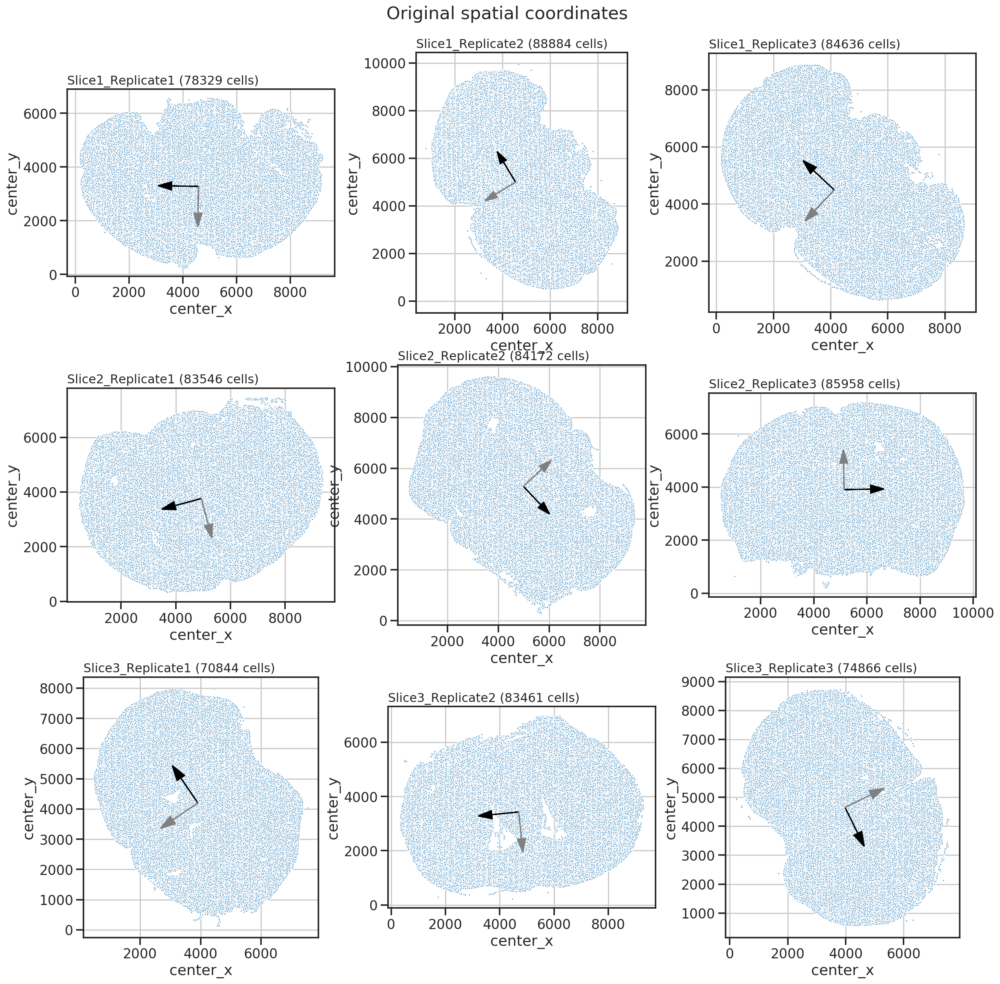

In [55]:
#  
x, y, suptitle = 'center_x', 'center_y', 'Original spatial coordinates'
fig, axs = plt.subplots(3, 3, figsize=(20,20))
for i, (ax, sample) in enumerate(zip(axs.flat, alldata.keys())):
    toplot = alldata[sample]
    Vt = all_Vts[sample]
    
    sns.scatterplot(x=x, y=y, data=toplot, 
                    s=4, markers=dict(marker_edge_color='none'),
                    rasterized=True,
                    ax=ax,
                   )
    ax.set_aspect('equal')
    xmean, ymean = toplot[x].mean(), toplot[y].mean()
    scale = 1000
    ax.arrow(xmean, ymean, scale*Vt[0,0], scale*Vt[0,1], 
             head_width=0.3*scale, head_length=0.5*scale, fc='k', ec='k')
    ax.arrow(xmean, ymean, scale*Vt[1,0], scale*Vt[1,1], 
             head_width=0.3*scale, head_length=0.5*scale, fc='gray', ec='gray')
    ax.set_title("{} ({} cells)".format(sample, len(toplot)), loc='left', fontsize=15)
fig.suptitle(suptitle, y=0.92)
plt.show()

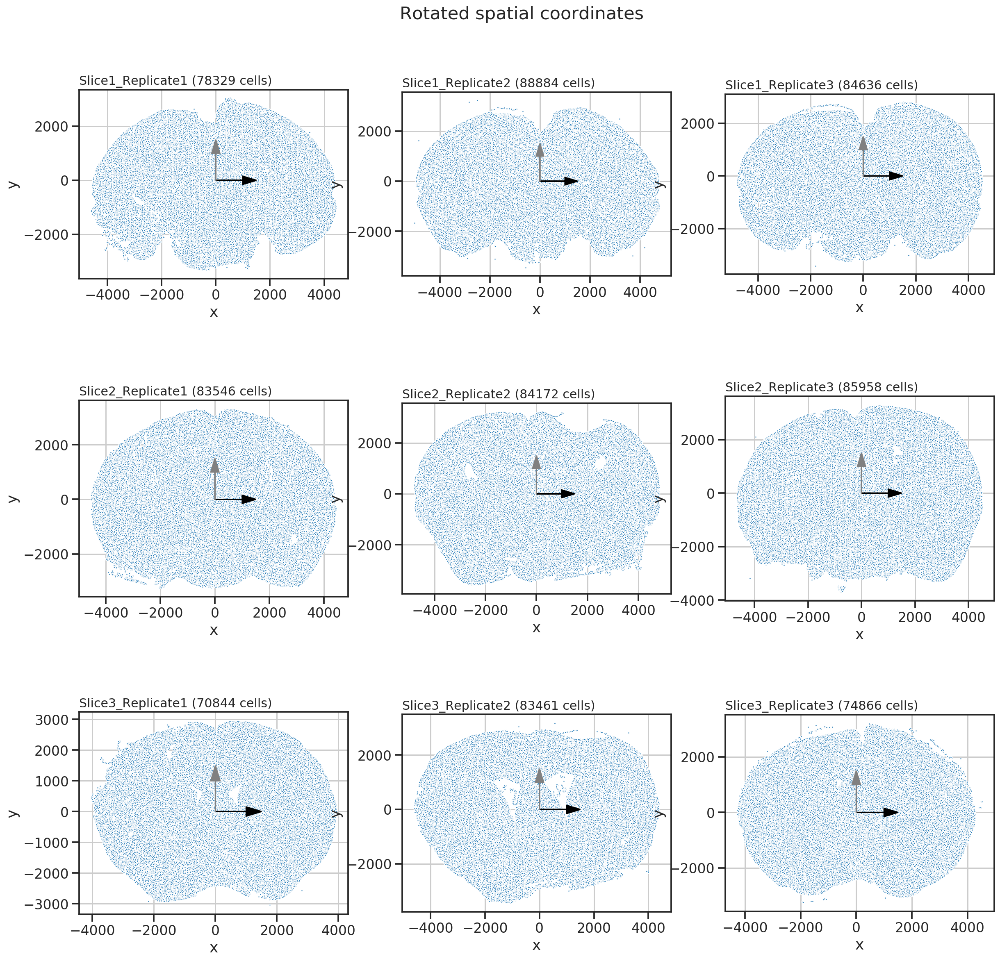

In [56]:
#  
x, y, suptitle = 'x', 'y', 'Rotated spatial coordinates'
fig, axs = plt.subplots(3, 3, figsize=(20,20))
for i, (ax, sample) in enumerate(zip(axs.flat, alldata.keys())):
    toplot = alldata[sample]
    Vt = all_Vts[sample]
    Vt = Vt.dot(Vt.T)
    
    sns.scatterplot(x=x, y=y, data=toplot, 
                    s=4, markers=dict(marker_edge_color='none'),
                    rasterized=True,
                    ax=ax,
                   )
    ax.set_aspect('equal')
    xmean, ymean = toplot[x].mean(), toplot[y].mean()
    scale = 1000
    ax.arrow(xmean, ymean, scale*Vt[0,0], scale*Vt[0,1], 
             head_width=0.3*scale, head_length=0.5*scale, fc='k', ec='k')
    ax.arrow(xmean, ymean, scale*Vt[1,0], scale*Vt[1,1], 
             head_width=0.3*scale, head_length=0.5*scale, fc='gray', ec='gray')
    ax.set_title("{} ({} cells)".format(sample, len(toplot)), loc='left', fontsize=15)
fig.suptitle(suptitle, y=0.92)
plt.show()

# Save results 

# Visualize genes

In [57]:
ndownsamp = 40000
downsampled_data = {}
for sample in alldata.keys():
    downsampled_data[sample] = alldata[sample].sample(n=ndownsamp)

In [64]:
def plot_FISH(gene):
    output = '{}/{}_{}.png'.format(output_dir, sample_name, gene)
#     print(output)
    
    fig, axs = plt.subplots(3, 3, figsize=(15,15))
    cax = fig.add_axes([0.95, 0.7, 0.02, 0.1])
    for i, (ax, sample) in enumerate(zip(axs.flat, alldata.keys())):
#         toplot = downsampled_data[sample]
        toplot = alldata[sample]
        vmaxp = 99
        vmin, vmax = 0, np.percentile(toplot[gene], vmaxp)
        x, y = 'x', 'y'
        sns.scatterplot(x=x, y=y, hue=gene, data=toplot, 
                        s=1, linewidth=0, alpha=0.3,
                        legend=False, 
                        rasterized=True, 
                        vmin=vmin, 
                        vmax=vmax,
                        ax=ax,
                       )
        sns.scatterplot(x=x, y=y, hue=gene, data=toplot[toplot[gene]>0], 
                        s=3, linewidth=0, alpha=1,
                        legend=False,
                        rasterized=True, 
                        vmin=vmin, 
                        vmax=vmax,
                        ax=ax,
                       )
        ax.axis('off')
        ax.set_aspect('equal')
        ax.set_title("{}".format(sample), loc='left', fontsize=15)
        
    # colorbar
    norm = plt.Normalize(0, vmaxp)
    sm = plt.cm.ScalarMappable(cmap="rocket_r", norm=norm,)
    fig.colorbar(sm, cax=cax, label='Percentile per slice', ticks=[0, vmaxp])

    fig.suptitle(gene, y=0.92, fontsize=18)
#     snmcseq_utils.savefig(fig, output)
#     plt.close()
    

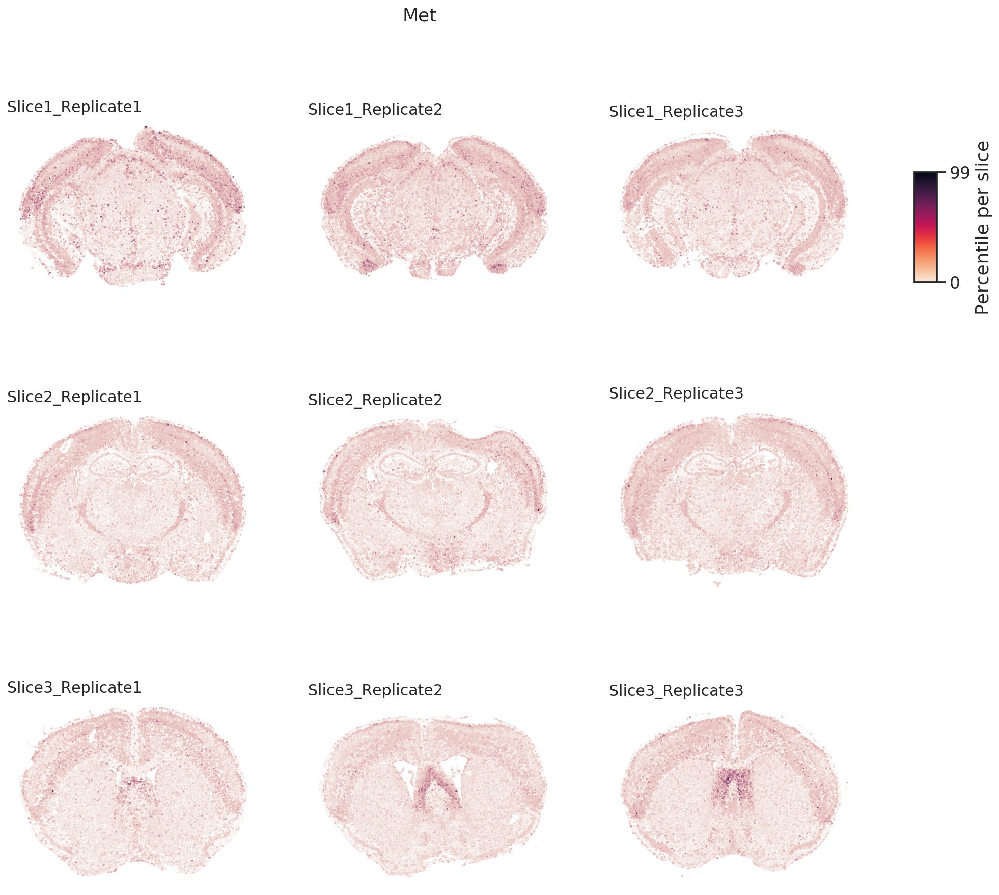

In [65]:
plot_FISH('Met')

  0%|          | 0/483 [00:04<?, ?it/s]

4.885156631469727


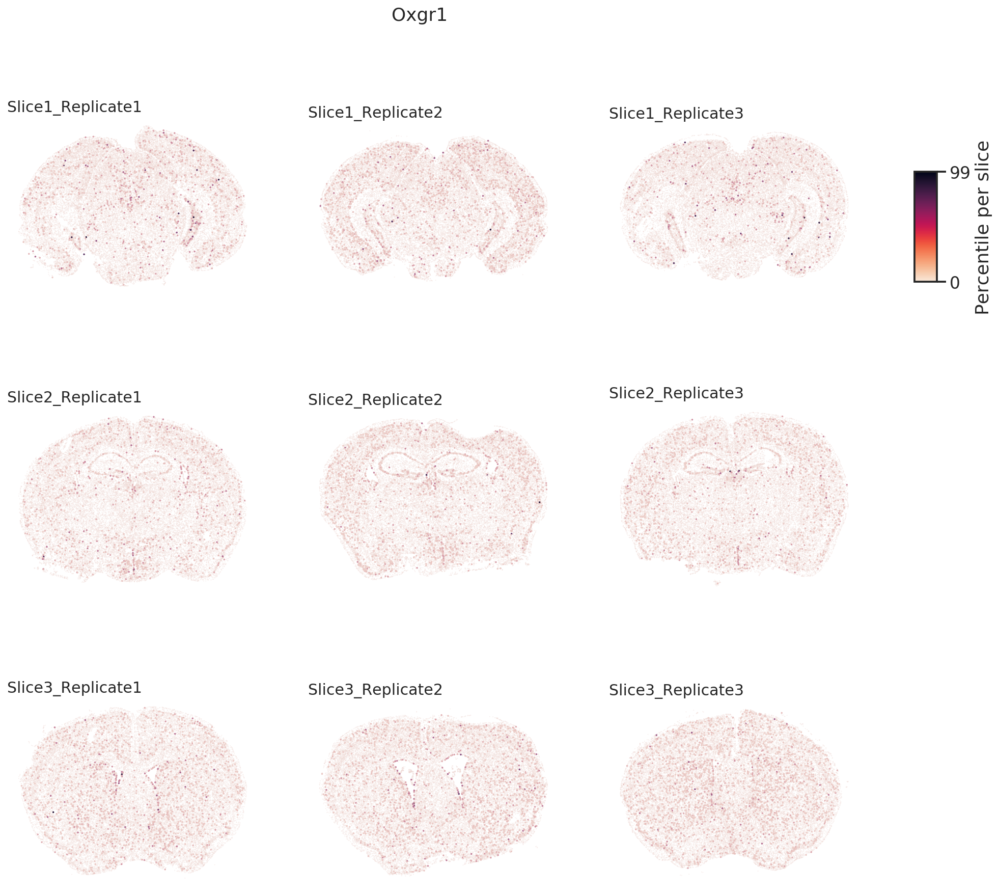

In [59]:
output_dir = './results_may1'
if not os.path.isdir(output_dir):
    os.makedirs(output_dir)


ti = time.time()
for gene in tqdm.tqdm(genes):
    plot_FISH(gene)
    print(time.time()-ti)
    break

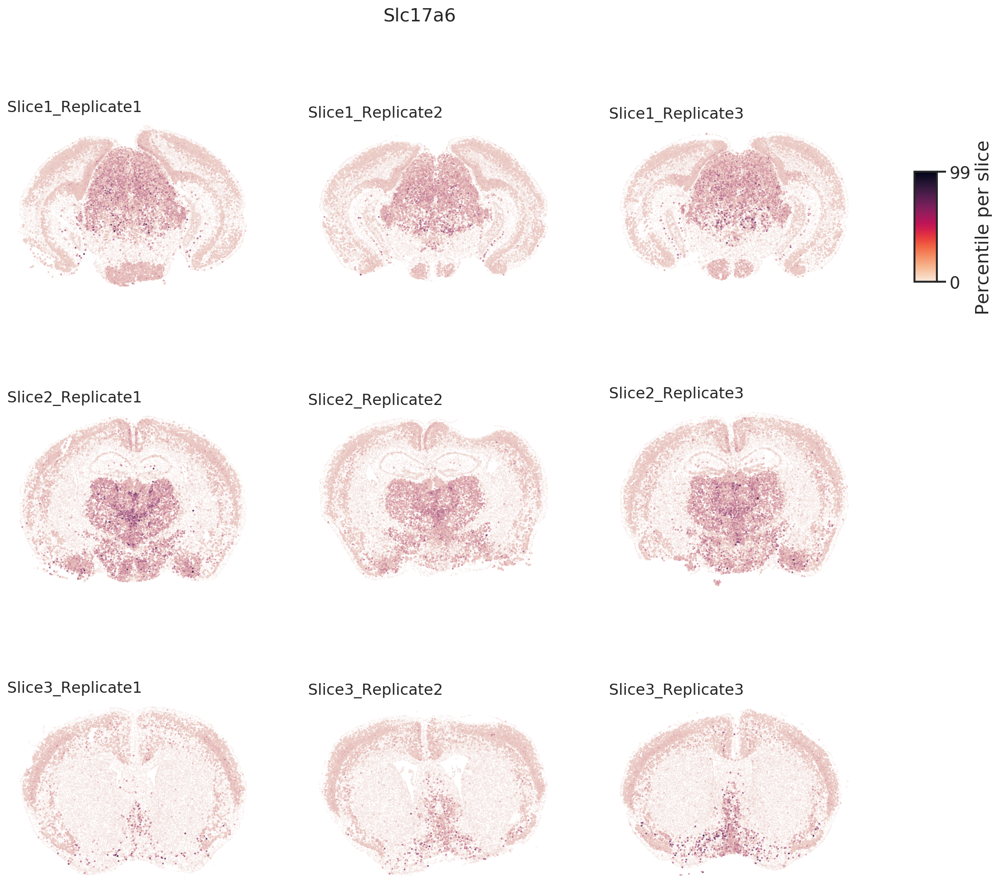

In [60]:
plot_FISH('Slc17a6')

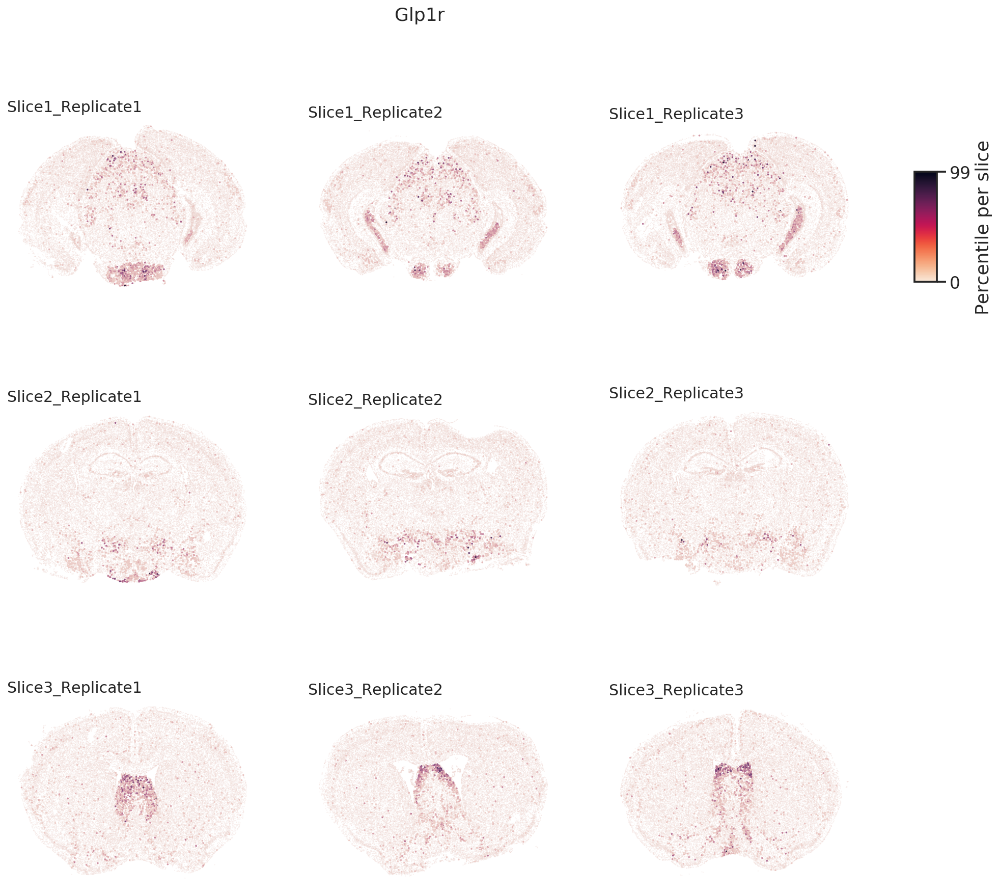

In [61]:
plot_FISH('Glp1r')

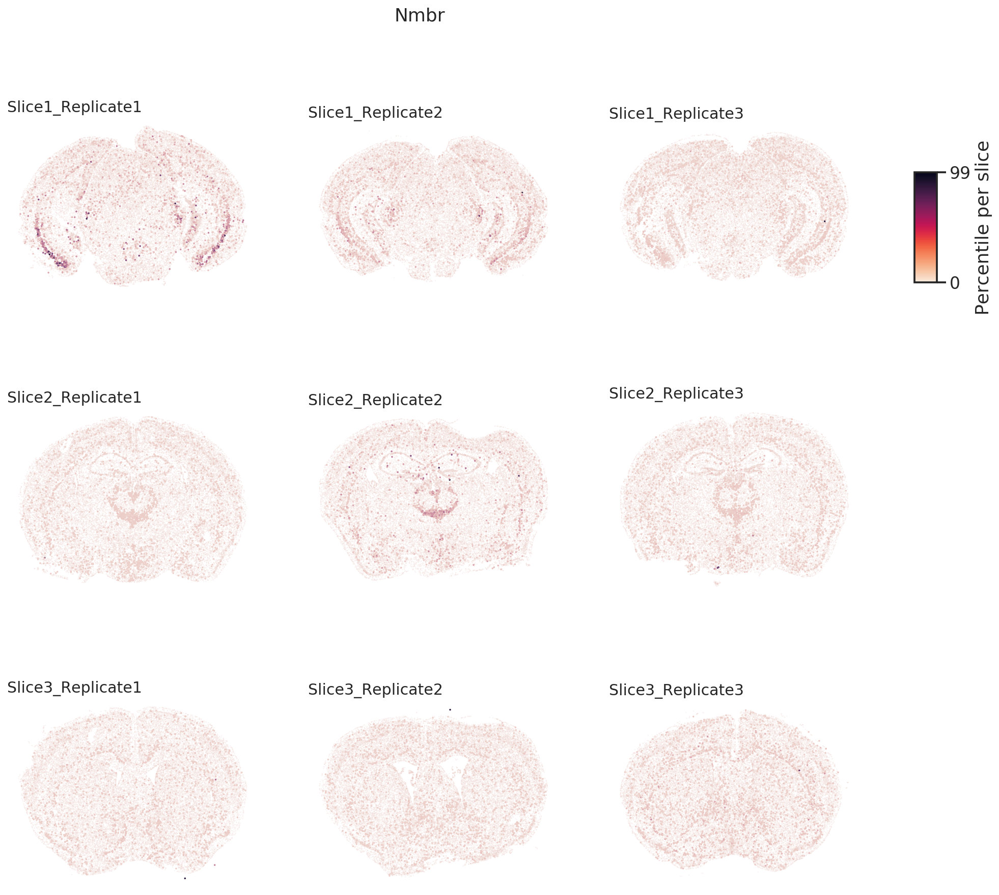

In [62]:
plot_FISH('Nmbr')